# 15-1. 프로젝트 : 스티커를 붙여주자

In [1]:
import tensorflow as tf
import numpy as np
import cv2

print(tf.__version__)
print(np.__version__)
print(cv2.__version__)

2.6.0
1.21.4
4.5.3


In [2]:
import os, time
import tqdm
import math
from itertools import product
import matplotlib.pyplot as plt

### Step 1. 스티커 구하기 혹은 만들기
---
왕관 또는 고양이 수염 등을 구하거나 혹은 다양한 아이디어의 스티커를 만들어 볼 수 있을 것입니다.

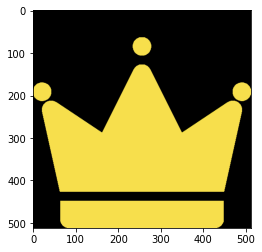

In [3]:
# 왕관 스티커 이미지 불러오기
sticker_path = os.getenv('HOME') + '/aiffel/camera_sticker/images/king.png'
img_sticker = cv2.imread(sticker_path, cv2.IMREAD_UNCHANGED)
plt.imshow(cv2.cvtColor(img_sticker, cv2.COLOR_BGR2RGB))

### Step 2. SSD 모델을 통해 얼굴 bounding box 찾기
---
우리는 실습 코드를 진행하며 필요한 모델을 이미 생성해 왔을 것입니다. 잘 훈련된 해당 모델을 통해 적절한 얼굴 bounding box를 찾아내 봅시다. inference.py 코드를 적극적으로 참고해 보시기를 권합니다.

#### WIDER FACE Bounding Box

In [4]:
PROJECT_PATH = os.getenv('HOME')+'/aiffel/face_detector'
DATA_PATH = os.path.join(PROJECT_PATH, 'widerface')
MODEL_PATH = os.path.join(PROJECT_PATH, 'checkpoints')
TRAIN_TFRECORD_PATH = os.path.join(PROJECT_PATH, 'dataset', 'train_mask.tfrecord')
VALID_TFRECORD_PATH = os.path.join(PROJECT_PATH, 'dataset', 'val_mask.tfrecord')
CHECKPOINT_PATH = os.path.join(PROJECT_PATH, 'checkpoints')

DATASET_LEN = 12880
BATCH_SIZE = 32
IMAGE_WIDTH = 320
IMAGE_HEIGHT = 256
IMAGE_LABELS = ['background', 'face']

In [5]:
def parse_box(data):
    x0 = int(data[0])
    y0 = int(data[1])
    w = int(data[2])
    h = int(data[3])
    return x0, y0, w, h

In [6]:
def parse_widerface(file):
    infos = []
    with open(file) as fp:
        line = fp.readline()
        while line:
            n_object = int(fp.readline())
            boxes = []
            for i in range(n_object):
                box = fp.readline().split(' ')
                x0, y0, w, h = parse_box(box)
                if (w == 0) or (h == 0):
                    continue
                boxes.append([x0, y0, w, h])
            if n_object == 0:
                box = fp.readline().split(' ')
                x0, y0, w, h = parse_box(box)
                boxes.append([x0, y0, w, h])
            infos.append((line.strip(), boxes))
            line = fp.readline()
    return infos

위 함수는 이미지별 bounding box 정보를 wider_face_train_bbx_gt.txt에서 파싱해서 리스트로 추출하는 것입니다.

이제 추출된 정보를 실제 이미지 정보와 결합합니다. bounding box 정보는 [x, y, w, h] 형태로 저장되어 있는데, [x_min, y_min, x_max, y_max] 형태의 꼭짓점 좌표 정보로 변환할 거예요.

이렇게 정보를 결합해야 나중에 학습에 사용하기 좋습니다.

In [7]:
def process_image(image_file):
    image_string = tf.io.read_file(image_file)
    try:
        image_data = tf.image.decode_jpeg(image_string, channels=3)
        return 0, image_string, image_data
    except tf.errors.InvalidArgumentError:
        return 1, image_string, None

In [8]:
def xywh_to_voc(file_name, boxes, image_data):
    shape = image_data.shape
    image_info = {}
    image_info['filename'] = file_name
    image_info['width'] = shape[1]
    image_info['height'] = shape[0]
    image_info['depth'] = 3

    difficult = []
    classes = []
    xmin, ymin, xmax, ymax = [], [], [], []

    for box in boxes:
        classes.append(1)
        difficult.append(0)
        xmin.append(box[0])
        ymin.append(box[1])
        xmax.append(box[0] + box[2])
        ymax.append(box[1] + box[3])
    image_info['class'] = classes
    image_info['xmin'] = xmin
    image_info['ymin'] = ymin
    image_info['xmax'] = xmax
    image_info['ymax'] = ymax
    image_info['difficult'] = difficult

    return image_info

In [9]:
file_path = os.path.join(DATA_PATH, 'wider_face_split', 'wider_face_train_bbx_gt.txt')
for i, info in enumerate(parse_widerface(file_path)):
    print('--------------------')
    image_file = os.path.join(DATA_PATH, 'WIDER_train', 'images', info[0])
    _, image_string, image_data = process_image(image_file)
    boxes = xywh_to_voc(image_file, info[1], image_data)
    print(boxes)
    if i > 3:
        break

--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_marchingband_1_849.jpg', 'width': 1024, 'height': 1385, 'depth': 3, 'class': [1], 'xmin': [449], 'ymin': [330], 'xmax': [571], 'ymax': [479], 'difficult': [0]}
--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_Parade_0_904.jpg', 'width': 1024, 'height': 1432, 'depth': 3, 'class': [1], 'xmin': [361], 'ymin': [98], 'xmax': [624], 'ymax': [437], 'difficult': [0]}
--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_marchingband_1_799.jpg', 'width': 1024, 'height': 768, 'depth': 3, 'class': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 'xmin': [78, 78, 113, 134, 163, 201, 182, 245, 304, 328, 389, 406, 436, 522, 643, 653, 793, 535, 29, 3, 20], 'ymin': [221, 238, 212, 260, 250, 218, 266, 279, 265, 295, 281, 293, 290, 328, 320, 224, 337, 311, 22

### TFRecord 만들기
---
오늘 다루게 될 대용량 데이터셋의 처리속도 향상을 위해서, 전처리 작업을 통해 TFRecord 데이터셋으로 변환할 필요가 있습니다. TFRecord란 TensorFlow만의 학습 데이터 저장 포맷으로, 이진(binary) 레코드의 시퀀스를 저장합니다. TFRecord 형태의 학습 데이터를 사용하여 모델 학습을 하면 학습 속도가 개선된다는 장점이 있습니다.

TFRecord는 여러 개의 tf.train.Example로 이루어져 있고, 한 개의 tf.train.Example은 여러 개의 tf.train.Feature로 이루어져 있습니다.

데이터의 단위를 이루는 tf.train.Example 인스턴스를 생성하는 메소드는 아래와 같습니다.

In [10]:
def make_example(image_string, image_infos):
    for info in image_infos:
        filename = info['filename']
        width = info['width']
        height = info['height']
        depth = info['depth']
        classes = info['class']
        xmin = info['xmin']
        ymin = info['ymin']
        xmax = info['xmax']
        ymax = info['ymax']

    if isinstance(image_string, type(tf.constant(0))):
        encoded_image = [image_string.numpy()]
    else:
        encoded_image = [image_string]

    base_name = [tf.compat.as_bytes(os.path.basename(filename))]
    
    example = tf.train.Example(features=tf.train.Features(feature={
        'filename':tf.train.Feature(bytes_list=tf.train.BytesList(value=base_name)),
        'height':tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'width':tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'classes':tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'x_mins':tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'y_mins':tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'x_maxes':tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'y_maxes':tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image_raw':tf.train.Feature(bytes_list=tf.train.BytesList(value=encoded_image))
    }))
    
    return example

In [11]:
for split in ['train', 'val']:
    if split == 'train':
        output_file = TRAIN_TFRECORD_PATH 
        anno_txt = 'wider_face_train_bbx_gt.txt'
        file_path = 'WIDER_train'
    else:
        output_file = VALID_TFRECORD_PATH
        anno_txt = 'wider_face_val_bbx_gt.txt'
        file_path = 'WIDER_val'

    with tf.io.TFRecordWriter(output_file) as writer:
        for info in tqdm.tqdm(parse_widerface(os.path.join(DATA_PATH, 'wider_face_split', anno_txt))):
            image_file = os.path.join(DATA_PATH, file_path, 'images', info[0])
            error, image_string, image_data = process_image(image_file)
            boxes = xywh_to_voc(image_file, info[1], image_data)

            if not error:
                tf_example = make_example(image_string, [boxes])
                writer.write(tf_example.SerializeToString())

100%|██████████| 3226/3226 [00:13<00:00, 233.04it/s]


In [12]:
# 생성된 TFRecord 파일 확인
!ls ~/aiffel/face_detector/dataset

train_mask.tfrecord  val_mask.tfrecord


#### Default boxes

In [13]:
BOX_MIN_SIZES = [[10, 16, 24], [32, 48], [64, 96], [128, 192, 256]]
BOX_STEPS = [8, 16, 32, 64]

In [14]:
image_sizes = (IMAGE_HEIGHT, IMAGE_WIDTH)
min_sizes = BOX_MIN_SIZES
steps= BOX_STEPS

feature_maps = [
    [math.ceil(image_sizes[0] / step), math.ceil(image_sizes[1] / step)]
    for step in steps
]
feature_maps

[[32, 40], [16, 20], [8, 10], [4, 5]]

In [15]:
boxes = []
for k, f in enumerate(feature_maps):
    for i, j in product(range(f[0]), range(f[1])):
        for min_size in min_sizes[k]:
            s_kx = min_size / image_sizes[1]
            s_ky = min_size / image_sizes[0]
            cx = (j + 0.5) * steps[k] / image_sizes[1]
            cy = (i + 0.5) * steps[k] / image_sizes[0]
            boxes += [cx, cy, s_kx, s_ky]

len(boxes)

18800

In [16]:
pretty_boxes = np.asarray(boxes).reshape([-1, 4])
print(pretty_boxes.shape)
print(pretty_boxes)

(4700, 4)
[[0.0125    0.015625  0.03125   0.0390625]
 [0.0125    0.015625  0.05      0.0625   ]
 [0.0125    0.015625  0.075     0.09375  ]
 ...
 [0.9       0.875     0.4       0.5      ]
 [0.9       0.875     0.6       0.75     ]
 [0.9       0.875     0.8       1.       ]]


In [17]:
def default_box():
    image_sizes = (IMAGE_HEIGHT, IMAGE_WIDTH)
    min_sizes = BOX_MIN_SIZES
    steps= BOX_STEPS
    feature_maps = [
        [math.ceil(image_sizes[0] / step), math.ceil(image_sizes[1] / step)]
        for step in steps
    ]
    boxes = []
    for k, f in enumerate(feature_maps):
        for i, j in product(range(f[0]), range(f[1])):
            for min_size in min_sizes[k]:
                s_kx = min_size / image_sizes[1]
                s_ky = min_size / image_sizes[0]
                cx = (j + 0.5) * steps[k] / image_sizes[1]
                cy = (i + 0.5) * steps[k] / image_sizes[0]
                boxes += [cx, cy, s_kx, s_ky]
    boxes = np.asarray(boxes).reshape([-1, 4])
    return boxes

#### SSD model 빌드

In [18]:
def _conv_block(inputs, filters, kernel=(3, 3), strides=(1, 1)):
    """
    컨볼루션 블록 (Conv2D → BatchNormalization → ReLU)
    
    Args:
        inputs (tf.Tensor): 입력 텐서.
        filters (int): Conv2D 레이어의 필터 수.
        kernel (tuple): 커널(필터) 크기, 기본값 (3, 3).
        strides (tuple): 스트라이드(Stride) 크기, 기본값 (1, 1).
    
    Returns:
        tf.Tensor: Conv2D → BatchNormalization → ReLU를 거친 출력 텐서.
    """
    # 블록의 고유 ID 생성 (레이어 이름을 고유하게 설정하기 위해 사용)
    block_id = (tf.keras.backend.get_uid())
    
    # 1. 다운샘플링이 필요한 경우 (strides가 (2, 2)인 경우)
    if strides == (2, 2):
        # (1) Zero Padding 적용 (경계 부분을 1 픽셀씩 패딩)
        x = tf.keras.layers.ZeroPadding2D(
            padding=((1, 1), (1, 1)), 
            name='conv_pad_%d' % block_id
        )(inputs)
        
        # (2) Conv2D 적용 (패딩은 'valid', 다운샘플링 수행)
        x = tf.keras.layers.Conv2D(
            filters,        # 필터 수
            kernel,         # 커널 크기 (3x3)
            padding='valid',# 유효한 영역만 적용 (패딩 없음)
            use_bias=False, # 바이어스 사용 안 함 (BatchNormalization으로 대체)
            strides=strides,# 다운샘플링 수행
            name='conv_%d' % block_id
        )(x)
    
    # 2. 일반적인 컨볼루션 (strides가 (1, 1)인 경우)
    else:
        x = tf.keras.layers.Conv2D(
            filters,        # 필터 수
            kernel,         # 커널 크기 (3x3)
            padding='same', # 입력과 출력 크기를 동일하게 유지
            use_bias=False, # 바이어스 사용 안 함 (BatchNormalization으로 대체)
            strides=strides,# 다운샘플링 없이 이동
            name='conv_%d' % block_id
        )(inputs)
    
    # 3. BatchNormalization (활성화 이전에 정규화)
    x = tf.keras.layers.BatchNormalization(
        name='conv_bn_%d' % block_id
    )(x)
    
    # 4. 활성화 함수 (ReLU)
    return tf.keras.layers.ReLU(
        name='conv_relu_%d' % block_id
    )(x)

In [19]:
def _depthwise_conv_block(inputs, filters, strides=(1, 1)):
    """
    Depthwise Separable Convolution 블록.
    
    DepthwiseConv2D → BatchNormalization → ReLU →
    Pointwise Conv2D → BatchNormalization → ReLU
    
    Args:
        inputs (tf.Tensor): 입력 텐서.
        filters (int): Pointwise Convolution의 필터 수.
        strides (tuple): 스트라이드(Stride) 크기, 기본값 (1, 1).
    
    Returns:
        tf.Tensor: Depthwise 및 Pointwise Conv를 거친 출력 텐서.
    """
    # 블록의 고유 ID 생성 (레이어 이름을 고유하게 설정하기 위해 사용)
    block_id = tf.keras.backend.get_uid()
    
    # 1. 스트라이드가 (1,1)인 경우 패딩 불필요
    if strides == (1, 1):
        x = inputs  # 입력 그대로 사용
    else:
        # 2. 스트라이드가 (2,2)인 경우 패딩 추가 (다운샘플링 필요)
        x = tf.keras.layers.ZeroPadding2D(
            ((1, 1), (1, 1)), 
            name='conv_pad_%d' % block_id
        )(inputs)
    
    # 3. Depthwise Convolution 적용
    x = tf.keras.layers.DepthwiseConv2D(
        (3, 3),               # 커널 크기 (3x3)
        padding='same' if strides == (1, 1) else 'valid',  # 스트라이드에 따라 패딩 설정
        strides=strides,      # 스트라이드 크기
        use_bias=False,       # 바이어스 사용 안 함 (BatchNormalization으로 대체)
        name='conv_dw_%d' % block_id
    )(x)
    
    # 4. BatchNormalization (DepthwiseConv2D 출력 정규화)
    x = tf.keras.layers.BatchNormalization(
        name='conv_dw_%d_bn' % block_id
    )(x)
    
    # 5. ReLU 활성화 함수 (DepthwiseConv2D 출력에 적용)
    x = tf.keras.layers.ReLU(
        name='conv_dw_%d_relu' % block_id
    )(x)
    
    # 6. Pointwise Convolution 적용 (1x1 컨볼루션으로 채널 결합)
    x = tf.keras.layers.Conv2D(
        filters,         # 필터 수 (출력 채널 수)
        (1, 1),          # 커널 크기 (1x1)
        padding='same',  # 입력과 출력 크기 동일
        use_bias=False,  # 바이어스 사용 안 함
        strides=(1, 1),  # 스트라이드 1
        name='conv_pw_%d' % block_id
    )(x)
    
    # 7. BatchNormalization (PointwiseConv2D 출력 정규화)
    x = tf.keras.layers.BatchNormalization(
        name='conv_pw_%d_bn' % block_id
    )(x)
    
    # 8. ReLU 활성화 함수 (최종 출력에 적용)
    return tf.keras.layers.ReLU(
        name='conv_pw_%d_relu' % block_id
    )(x)

In [20]:
def _branch_block(inputs, filters):
    """
    Branch Block (Conv2D → LeakyReLU → Conv2D → Conv2D → Concatenate → ReLU)
    
    Args:
        inputs (tf.Tensor): 입력 텐서.
        filters (int): 첫 번째 및 두 번째 Conv2D 레이어의 필터 수.
    
    Returns:
        tf.Tensor: 두 가지 경로의 Conv2D 출력을 병합한 결과 텐서.
    """
    
    # 1. 첫 번째 경로: Conv2D → LeakyReLU → Conv2D
    x = tf.keras.layers.Conv2D(
        filters,               # 필터 수
        kernel_size=(3, 3),    # 커널 크기 (3x3)
        padding='same'         # 출력 크기를 입력과 동일하게 유지
    )(inputs)  # 첫 번째 Conv2D 레이어 적용
    
    x = tf.keras.layers.LeakyReLU()(x)  # LeakyReLU 활성화 함수 적용
    
    x = tf.keras.layers.Conv2D(
        filters,               # 필터 수
        kernel_size=(3, 3),    # 커널 크기 (3x3)
        padding='same'         # 출력 크기 동일 유지
    )(x)  # 두 번째 Conv2D 레이어 적용
    
    # 2. 두 번째 경로: Conv2D
    x1 = tf.keras.layers.Conv2D(
        filters * 2,           # 두 번째 경로는 필터 수를 두 배로 설정
        kernel_size=(3, 3),    # 커널 크기 (3x3)
        padding='same'         # 출력 크기 동일 유지
    )(inputs)  # 두 번째 Conv2D 레이어 적용 (직접 inputs 사용)
    
    # 3. 두 경로의 출력을 Concatenate
    x = tf.keras.layers.Concatenate(axis=-1)([x, x1])  # 두 출력 텐서를 채널 방향으로 결합
    
    # 4. 최종 ReLU 활성화 함수 적용
    return tf.keras.layers.ReLU()(x)  # 병합된 출력에 ReLU 활성화 함수 적용

In [21]:
def _create_head_block(inputs, filters):
    """
    Head Block (Conv2D)
    
    SSD 모델의 최종 예측을 위한 특징 맵을 생성합니다.
    
    Args:
        inputs (tf.Tensor): 입력 텐서.
        filters (int): Conv2D 레이어의 필터 수.
    
    Returns:
        tf.Tensor: Conv2D를 통과한 출력 텐서.
    """
    
    # 1. Conv2D 레이어 적용
    x = tf.keras.layers.Conv2D(
        filters=filters,       # 출력 채널(필터)의 수
        kernel_size=(3, 3),    # 커널(필터)의 크기 (3x3)
        strides=(1, 1),        # 스트라이드 (1,1) → 출력 크기 유지
        padding='same'         # 'same' 패딩 → 입력과 출력 크기를 동일하게 유지
    )(inputs)  # 입력 텐서에 Conv2D 연산 적용
    
    # 2. 결과 텐서 반환
    return x

In [22]:
def _compute_heads(inputs, num_class, num_cell):
    """
    SSD 헤드(Head) 블록 생성
    
    Classification(클래스 예측)과 Localization(위치 예측) 헤드를 생성합니다.
    
    Args:
        inputs (tf.Tensor): 입력 텐서 (특징 맵).
        num_class (int): 예측할 객체 클래스 수.
        num_cell (int): 각 특징 맵에서 예측할 셀(cell)의 수.
    
    Returns:
        conf (tf.Tensor): 클래스 예측 텐서. Shape: (Batch, Num_Boxes, num_class)
        loc (tf.Tensor): 위치 예측 텐서. Shape: (Batch, Num_Boxes, 4)
    """
    
    # 1. Classification Head (객체 클래스 예측)
    # 각 셀마다 num_class(클래스 수) * num_cell(셀 수) 만큼의 출력을 생성
    conf = _create_head_block(inputs, num_cell * num_class)  # Conv2D로 특징 추출
    conf = tf.keras.layers.Reshape(
        (-1, num_class)  # (Batch, Num_Boxes, num_class) 형태로 변환
    )(conf)
    
    # 2. Localization Head (객체 위치 예측)
    # 각 셀마다 4개의 좌표(xmin, ymin, xmax, ymax) * num_cell(셀 수) 만큼의 출력을 생성
    loc = _create_head_block(inputs, num_cell * 4)  # Conv2D로 특징 추출
    loc = tf.keras.layers.Reshape(
        (-1, 4)  # (Batch, Num_Boxes, 4) 형태로 변환
    )(loc)
    
    # 3. Classification과 Localization 출력 반환
    return conf, loc

In [23]:
def MySsdModel():
    # 기본 채널 수 설정
    base_channel = 16  # 초기 컨볼루션 필터 수
    num_cells = [3, 2, 2, 3]  # 각 피처맵 레이어에서 셀에서 사용할 예측 Default boxes 수
    num_class = len(IMAGE_LABELS)  # 클래스 수 (객체 클래스 + 배경 포함)
    
    # 입력 이미지 레이어 정의
    x = inputs = tf.keras.layers.Input(shape=[IMAGE_HEIGHT, IMAGE_WIDTH, 3], name='input_image')
    
    # 기본 특징 맵 생성 (Convolution Blocks)
    x = _conv_block(x, base_channel, strides=(2, 2))      # 첫 번째 컨볼루션 블록
    x = _conv_block(x, base_channel * 2, strides=(1, 1))  # 두 번째 블록
    x = _conv_block(x, base_channel * 2, strides=(2, 2))  # 다운샘플링
    x = _conv_block(x, base_channel * 2, strides=(1, 1))  # 특징 학습
    
    # 두 번째 피처맵 블록
    x = _conv_block(x, base_channel * 4, strides=(2, 2))  # 다운샘플링
    x = _conv_block(x, base_channel * 4, strides=(1, 1))  # 특징 학습
    x = _conv_block(x, base_channel * 4, strides=(1, 1))  
    x = _conv_block(x, base_channel * 4, strides=(1, 1))  
    x1 = _branch_block(x, base_channel)  # 첫 번째 예측 피처맵 저장
    
    # 세 번째 피처맵 블록
    x = _conv_block(x, base_channel * 8, strides=(2, 2))  # 다운샘플링
    x = _conv_block(x, base_channel * 8, strides=(1, 1))  # 특징 학습
    x = _conv_block(x, base_channel * 8, strides=(1, 1))  
    x2 = _branch_block(x, base_channel)  # 두 번째 예측 피처맵 저장
    
    # 네 번째 피처맵 블록 (Depthwise Convolution 사용)
    x = _depthwise_conv_block(x, base_channel * 16, strides=(2, 2))  # 다운샘플링
    x = _depthwise_conv_block(x, base_channel * 16, strides=(1, 1))  # 특징 학습
    x3 = _branch_block(x, base_channel)  # 세 번째 예측 피처맵 저장
    
    # 다섯 번째 피처맵 블록 (Depthwise Convolution 사용)
    x = _depthwise_conv_block(x, base_channel * 16, strides=(2, 2))  # 다운샘플링
    x4 = _branch_block(x, base_channel)  # 네 번째 예측 피처맵 저장
    
    # 예측에 사용될 피처맵 리스트
    extra_layers = [x1, x2, x3, x4]

    # 객체 분류 (conf) 및 위치 (loc) 예측 헤드 초기화
    confs = []  # 클래스 확률 저장
    locs = []   # 바운딩 박스 좌표 저장

    # 각 피처맵에서 예측 헤드 계산
    for layer, num_cell in zip(extra_layers, num_cells):
        conf, loc = _compute_heads(layer, num_class, num_cell)
        confs.append(conf)  # 클래스 확률 추가
        locs.append(loc)    # 객체 좌표 추가

    # 모든 피처맵에서 예측된 클래스 확률을 하나로 합침
    confs = tf.keras.layers.Concatenate(axis=1, name="face_classes")(confs)
    # 모든 피처맵에서 예측된 객체 좌표를 하나로 합침
    locs = tf.keras.layers.Concatenate(axis=1, name="face_boxes")(locs)

    # 최종 예측 레이어 (객체 좌표 + 클래스 확률)
    predictions = tf.keras.layers.Concatenate(axis=2, name='predictions')([locs, confs])

    # SSD 모델 정의
    model = tf.keras.Model(inputs=inputs, outputs=predictions, name='ssd_model')
    
    return model

#### Data augmentation

In [24]:
def _crop(img, labels, max_loop=250):
    shape = tf.shape(img)

    def matrix_iof(a, b):
        lt = tf.math.maximum(a[:, tf.newaxis, :2], b[:, :2])
        rb = tf.math.minimum(a[:, tf.newaxis, 2:], b[:, 2:])

        area_i = tf.math.reduce_prod(rb - lt, axis=2) * \
            tf.cast(tf.reduce_all(lt < rb, axis=2), tf.float32)
        area_a = tf.math.reduce_prod(a[:, 2:] - a[:, :2], axis=1)
        return area_i / tf.math.maximum(area_a[:, tf.newaxis], 1)

    def crop_loop_body(i, img, labels):
        valid_crop = tf.constant(1, tf.int32)

        pre_scale = tf.constant([0.3, 0.45, 0.6, 0.8, 1.0], dtype=tf.float32)
        scale = pre_scale[tf.random.uniform([], 0, 5, dtype=tf.int32)]
        short_side = tf.cast(tf.minimum(shape[0], shape[1]), tf.float32)
        h = w = tf.cast(scale * short_side, tf.int32)
        h_offset = tf.random.uniform([], 0, shape[0] - h + 1, dtype=tf.int32)
        w_offset = tf.random.uniform([], 0, shape[1] - w + 1, dtype=tf.int32)
        roi = tf.stack([w_offset, h_offset, w_offset + w, h_offset + h])
        roi = tf.cast(roi, tf.float32)

        value = matrix_iof(labels[:, :4], roi[tf.newaxis])
        valid_crop = tf.cond(tf.math.reduce_any(value >= 1),
                             lambda: valid_crop, lambda: 0)

        centers = (labels[:, :2] + labels[:, 2:4]) / 2
        mask_a = tf.reduce_all(
            tf.math.logical_and(roi[:2] < centers, centers < roi[2:]),
            axis=1)
        labels_t = tf.boolean_mask(labels, mask_a)
        valid_crop = tf.cond(tf.reduce_any(mask_a),
                             lambda: valid_crop, lambda: 0)

        img_t = img[h_offset:h_offset + h, w_offset:w_offset + w, :]
        h_offset = tf.cast(h_offset, tf.float32)
        w_offset = tf.cast(w_offset, tf.float32)
        labels_t = tf.stack(
            [labels_t[:, 0] - w_offset,  labels_t[:, 1] - h_offset,
             labels_t[:, 2] - w_offset,  labels_t[:, 3] - h_offset,
             labels_t[:, 4]], axis=1)

        return tf.cond(valid_crop == 1,
                       lambda: (max_loop, img_t, labels_t),
                       lambda: (i + 1, img, labels))

    _, img, labels = tf.while_loop(
        lambda i, img, labels: tf.less(i, max_loop),
        crop_loop_body,
        [tf.constant(-1), img, labels],
        shape_invariants=[tf.TensorShape([]),
                          tf.TensorShape([None, None, 3]),
                          tf.TensorShape([None, 5])])

    return img, labels

In [25]:
def _resize(img, labels):
    w_f = tf.cast(tf.shape(img)[1], tf.float32)
    h_f = tf.cast(tf.shape(img)[0], tf.float32)
    locs = tf.stack([labels[:, 0] / w_f,  labels[:, 1] / h_f,
                     labels[:, 2] / w_f,  labels[:, 3] / h_f] ,axis=1)
    locs = tf.clip_by_value(locs, 0, 1.0)
    labels = tf.concat([locs, labels[:, 4][:, tf.newaxis]], axis=1)

    resize_case = tf.random.uniform([], 0, 5, dtype=tf.int32)

    def resize(method):
        def _resize():
            #　size h,w
            return tf.image.resize(img, [IMAGE_HEIGHT, IMAGE_WIDTH], method=method, antialias=True)
        return _resize

    img = tf.case([(tf.equal(resize_case, 0), resize('bicubic')),
                   (tf.equal(resize_case, 1), resize('area')),
                   (tf.equal(resize_case, 2), resize('nearest')),
                   (tf.equal(resize_case, 3), resize('lanczos3'))],
                  default=resize('bilinear'))

    return img, labels

In [26]:
def _flip(img, labels):
    flip_case = tf.random.uniform([], 0, 2, dtype=tf.int32)

    def flip_func():
        flip_img = tf.image.flip_left_right(img)
        flip_labels = tf.stack([1 - labels[:, 2],  labels[:, 1],
                                1 - labels[:, 0],  labels[:, 3],
                                labels[:, 4]], axis=1)

        return flip_img, flip_labels

    img, labels = tf.case([(tf.equal(flip_case, 0), flip_func)],default=lambda: (img, labels))

    return img, labels

In [27]:
def _pad_to_square(img):
    height = tf.shape(img)[0]
    width = tf.shape(img)[1]

    def pad_h():
        img_pad_h = tf.ones([width - height, width, 3]) * tf.reduce_mean(img, axis=[0, 1], keepdims=True)
        return tf.concat([img, img_pad_h], axis=0)

    def pad_w():
        img_pad_w = tf.ones([height, height - width, 3]) * tf.reduce_mean(img, axis=[0, 1], keepdims=True)
        return tf.concat([img, img_pad_w], axis=1)

    img = tf.case([(tf.greater(height, width), pad_w),
                   (tf.less(height, width), pad_h)], default=lambda: img)
    return img

In [28]:
def _distort(img):
    img = tf.image.random_brightness(img, 0.4)
    img = tf.image.random_contrast(img, 0.5, 1.5)
    img = tf.image.random_saturation(img, 0.5, 1.5)
    img = tf.image.random_hue(img, 0.1)

    return img

#### Jaccard 유사도

In [29]:
def _intersect(box_a, box_b):
    A = tf.shape(box_a)[0]
    B = tf.shape(box_b)[0]
    max_xy = tf.minimum(
        tf.broadcast_to(tf.expand_dims(box_a[:, 2:], 1), [A, B, 2]),
        tf.broadcast_to(tf.expand_dims(box_b[:, 2:], 0), [A, B, 2]))
    min_xy = tf.maximum(
        tf.broadcast_to(tf.expand_dims(box_a[:, :2], 1), [A, B, 2]),
        tf.broadcast_to(tf.expand_dims(box_b[:, :2], 0), [A, B, 2]))
    inter = tf.clip_by_value(max_xy - min_xy, 0.0, 512.0)
    return inter[:, :, 0] * inter[:, :, 1]

In [30]:
def _jaccard(box_a, box_b):
    inter = _intersect(box_a, box_b)
    area_a = tf.broadcast_to(
        tf.expand_dims(
            (box_a[:, 2] - box_a[:, 0]) * (box_a[:, 3] - box_a[:, 1]), 1),
        tf.shape(inter))  # [A,B]
    area_b = tf.broadcast_to(
        tf.expand_dims(
            (box_b[:, 2] - box_b[:, 0]) * (box_b[:, 3] - box_b[:, 1]), 0),
        tf.shape(inter))  # [A,B]
    union = area_a + area_b - inter
    return inter / union  # [A,B]

- jaccard 메소드를 이용해 label의 ground truth bbox와 가장 overlap 비율이 높은 matched box를 구한다.
- _encode_bbox 메소드를 통해 bbox의 scale을 동일하게 보정한다.
- 전체 default box에 대해 일정 threshold 이상 overlap되는 ground truth bounding box 존재 여부(positive/negative)를 concat하여 새로운 label로 업데이트한다

In [31]:
def _encode_bbox(matched, boxes, variances=[0.1, 0.2]):
    g_cxcy = (matched[:, :2] + matched[:, 2:]) / 2 - boxes[:, :2]
    g_cxcy /= (variances[0] * boxes[:, 2:])
    g_wh = (matched[:, 2:] - matched[:, :2]) / boxes[:, 2:]
    g_wh = tf.math.log(g_wh) / variances[1]
    g_wh = tf.where(tf.math.is_inf(g_wh), 0.0, g_wh)
    return tf.concat([g_cxcy, g_wh], 1)

In [32]:
def encode_tf(labels, boxes):
    match_threshold = 0.45
    boxes = tf.cast(boxes, tf.float32)
    bbox = labels[:, :4]
    conf = labels[:, -1]
   
    # jaccard index
    overlaps = _jaccard(bbox, boxes)
    best_box_overlap = tf.reduce_max(overlaps, 1)
    best_box_idx = tf.argmax(overlaps, 1, tf.int32)

    best_truth_overlap = tf.reduce_max(overlaps, 0)
    best_truth_idx = tf.argmax(overlaps, 0, tf.int32)

    best_truth_overlap = tf.tensor_scatter_nd_update(
        best_truth_overlap, tf.expand_dims(best_box_idx, 1),
        tf.ones_like(best_box_idx, tf.float32) * 2.)
    best_truth_idx = tf.tensor_scatter_nd_update(
        best_truth_idx, tf.expand_dims(best_box_idx, 1),
        tf.range(tf.size(best_box_idx), dtype=tf.int32))
    # Scale Ground-Truth Boxes   
    matches_bbox = tf.gather(bbox, best_truth_idx)
    loc_t = _encode_bbox(matches_bbox, boxes)
    conf_t = tf.gather(conf, best_truth_idx)
    conf_t = tf.where(tf.less(best_truth_overlap, match_threshold), tf.zeros_like(conf_t), conf_t)

    return tf.concat([loc_t, conf_t[..., tf.newaxis]], axis=1)


#### load_dataset

- _transform_data : augmemtation과 label을 encoding 하여 기존의 dataset을 변환하는 메소드
- _parse_tfrecord : TFRecord 에 _transform_data를 적용하는 함수 클로저 생성
- load_tfrecord_dataset : tf.data.TFRecordDataset.map()에 _parse_tfrecord을 적용하는 실제 데이터셋 변환 메인 메소드
- load_dataset : load_tfrecord_dataset을 통해 train, validation 데이터셋을 생성하는 최종 메소드

In [33]:
def _transform_data(train, boxes):
    def transform_data(img, labels):
        img = tf.cast(img, tf.float32)
        if train:
            img, labels = _crop(img, labels)
            img = _pad_to_square(img)

        img, labels = _resize(img, labels)

        if train:
            img, labels = _flip(img, labels)

        if train:
            img = _distort(img)
        labels = encode_tf(labels, boxes)        
        img = img/255.0
        return img, labels
    return transform_data

In [34]:
def _parse_tfrecord(train, boxes):
    def parse_tfrecord(tfrecord):
        features = {
            'filename': tf.io.FixedLenFeature([], tf.string),
            'height': tf.io.FixedLenFeature([], tf.int64),
            'width': tf.io.FixedLenFeature([], tf.int64),
            'classes': tf.io.VarLenFeature(tf.int64),
            'x_mins': tf.io.VarLenFeature(tf.float32),
            'y_mins': tf.io.VarLenFeature(tf.float32),
            'x_maxes': tf.io.VarLenFeature(tf.float32),
            'y_maxes': tf.io.VarLenFeature(tf.float32),
            'difficult':tf.io.VarLenFeature(tf.int64),
            'image_raw': tf.io.FixedLenFeature([], tf.string),
           }

        parsed_example = tf.io.parse_single_example(tfrecord, features)
        img = tf.image.decode_jpeg(parsed_example['image_raw'], channels=3)

        width = tf.cast(parsed_example['width'], tf.float32)
        height = tf.cast(parsed_example['height'], tf.float32)

        labels = tf.sparse.to_dense(parsed_example['classes'])
        labels = tf.cast(labels, tf.float32)

        labels = tf.stack(
            [tf.sparse.to_dense(parsed_example['x_mins']),
             tf.sparse.to_dense(parsed_example['y_mins']),
             tf.sparse.to_dense(parsed_example['x_maxes']),
             tf.sparse.to_dense(parsed_example['y_maxes']),labels], axis=1)

        img, labels = _transform_data(train, boxes)(img, labels)

        return img, labels
    return parse_tfrecord

In [35]:
def load_tfrecord_dataset(tfrecord_name, train=True, boxes=None, buffer_size=1024):
    raw_dataset = tf.data.TFRecordDataset(tfrecord_name)
    raw_dataset = raw_dataset.cache()
    if train:
        raw_dataset = raw_dataset.repeat()
        raw_dataset = raw_dataset.shuffle(buffer_size=buffer_size)

    dataset = raw_dataset.map(_parse_tfrecord(train, boxes), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

In [36]:
def load_dataset(boxes, train=True, buffer_size=1024):
    if train:
        dataset = load_tfrecord_dataset(
            tfrecord_name=TRAIN_TFRECORD_PATH,
            train=train,
            boxes=boxes,
            buffer_size=buffer_size)
    else:
        dataset = load_tfrecord_dataset(
            tfrecord_name=VALID_TFRECORD_PATH,
            train=train,
            boxes=boxes,
            buffer_size=buffer_size)
    return dataset

#### Learning rate scheduler

In [37]:
class PiecewiseConstantWarmUpDecay(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, boundaries, values, warmup_steps, min_lr, name=None):
        super(PiecewiseConstantWarmUpDecay, self).__init__()

        if len(boundaries) != len(values) - 1:
            raise ValueError(
                    "The length of boundaries should be 1 less than the"
                    "length of values")

        self.boundaries = boundaries
        self.values = values
        self.name = name
        self.warmup_steps = warmup_steps
        self.min_lr = min_lr

    def __call__(self, step):
        with tf.name_scope(self.name or "PiecewiseConstantWarmUp"):
            step = tf.cast(tf.convert_to_tensor(step), tf.float32)
            pred_fn_pairs = []
            warmup_steps = self.warmup_steps
            boundaries = self.boundaries
            values = self.values
            min_lr = self.min_lr

            pred_fn_pairs.append(
                (step <= warmup_steps,
                 lambda: min_lr + step * (values[0] - min_lr) / warmup_steps))
            pred_fn_pairs.append(
                (tf.logical_and(step <= boundaries[0],
                                step > warmup_steps),
                 lambda: tf.constant(values[0])))
            pred_fn_pairs.append(
                (step > boundaries[-1], lambda: tf.constant(values[-1])))

            for low, high, v in zip(boundaries[:-1], boundaries[1:],
                                    values[1:-1]):
                pred = (step > low) & (step <= high)
                pred_fn_pairs.append((pred, lambda: tf.constant(v)))

            return tf.case(pred_fn_pairs, lambda: tf.constant(values[0]),
                           exclusive=True)

In [38]:
def MultiStepWarmUpLR(initial_learning_rate, lr_steps, lr_rate,
                      warmup_steps=0., min_lr=0.,
                      name='MultiStepWarmUpLR'):
    assert warmup_steps <= lr_steps[0]
    assert min_lr <= initial_learning_rate
    lr_steps_value = [initial_learning_rate]
    for _ in range(len(lr_steps)):
        lr_steps_value.append(lr_steps_value[-1] * lr_rate)
    return PiecewiseConstantWarmUpDecay(
        boundaries=lr_steps, values=lr_steps_value, warmup_steps=warmup_steps,
        min_lr=min_lr)

#### Hard negative mining

In [39]:
def hard_negative_mining(loss, class_truth, neg_ratio):
    pos_idx = class_truth > 0
    num_pos = tf.math.reduce_sum(tf.cast(pos_idx, tf.int32), axis=1)
    num_neg = num_pos * neg_ratio

    rank = tf.argsort(loss, axis=1, direction='DESCENDING')
    rank = tf.argsort(rank, axis=1)
    neg_idx = rank < tf.expand_dims(num_neg, 1)

    return pos_idx, neg_idx

In [40]:
def MultiBoxLoss(num_class, neg_pos_ratio=3.0):
    def multi_loss(y_true, y_pred):
        num_batch = tf.shape(y_true)[0]
        loc_pred, class_pred = y_pred[..., :4], y_pred[..., 4:]
        loc_truth, class_truth = y_true[..., :4], tf.squeeze(y_true[..., 4:])

        cross_entropy = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')
        temp_loss = cross_entropy(class_truth, class_pred)
        pos_idx, neg_idx = hard_negative_mining(temp_loss, class_truth, neg_pos_ratio)

        cross_entropy = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='sum')
        loss_class = cross_entropy(
            class_truth[tf.math.logical_or(pos_idx, neg_idx)],
            class_pred[tf.math.logical_or(pos_idx, neg_idx)])
        
        smooth_l1_loss = tf.keras.losses.Huber(reduction='sum')
        loss_loc = smooth_l1_loss(loc_truth[pos_idx],loc_pred[pos_idx])

        num_pos = tf.math.reduce_sum(tf.cast(pos_idx, tf.float32))

        loss_class = loss_class / num_pos
        loss_loc = loss_loc / num_pos
        return loss_loc, loss_class

    return multi_loss

In [41]:
boxes = default_box()
train_dataset = load_dataset(boxes, train=True)

In [42]:
steps_per_epoch = DATASET_LEN // BATCH_SIZE
learning_rate = MultiStepWarmUpLR(
    initial_learning_rate=1e-2,
    lr_steps=[e*steps_per_epoch for e in [50, 70]],
    lr_rate=0.1,
    warmup_steps=5*steps_per_epoch,
    min_lr=1e-4
)
optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9, nesterov=True)

multi_loss = MultiBoxLoss(len(IMAGE_LABELS), neg_pos_ratio=3)

Model: "ssd_model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, 256, 320, 3) 0                                            
__________________________________________________________________________________________________
conv_pad_1 (ZeroPadding2D)      (None, 258, 322, 3)  0           input_image[0][0]                
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 128, 160, 16) 432         conv_pad_1[0][0]                 
__________________________________________________________________________________________________
conv_bn_1 (BatchNormalization)  (None, 128, 160, 16) 64          conv_1[0][0]                     
__________________________________________________________________________________________

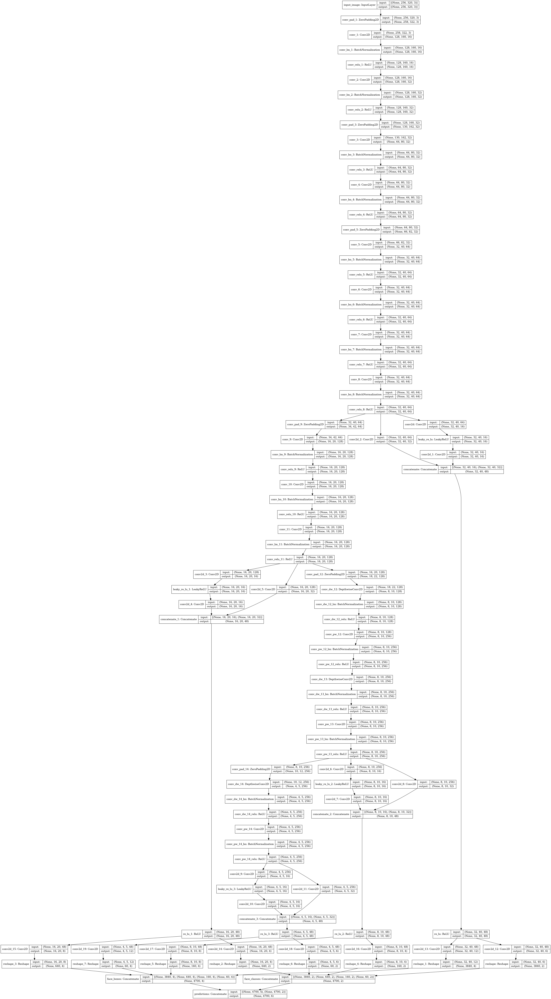

In [43]:
model = MySsdModel()
model.summary()
tf.keras.utils.plot_model(
    model, 
    to_file=os.path.join(os.getcwd(), 'model.png'),
    show_shapes=True, 
    show_layer_names=True
)

In [44]:
filepath = os.path.join(PROJECT_PATH, 'checkpoints', 'weights_epoch_008.h5')
model.load_weights(filepath)

### weights_epoch_008.h5 에서 100 epoch 추가 학습진행

In [45]:
CURRENT_DIR = os.getcwd()
# 모델 저장 경로*
BEST_MYMODEL_PATH = os.path.join(CURRENT_DIR, 'best_mymodel.h5')
print("모델 저장 경로:", BEST_MYMODEL_PATH)

모델 저장 경로: /aiffel/aiffel/AIFFEL_quest_rs/GoingDeeper/GD05/best_mymodel.h5


In [46]:
mymodel = MySsdModel()
mymodel.load_weights(filepath)

In [47]:
# @tf.function을 사용해 그래프 실행 최적화
@tf.function
def train_step(inputs, labels):
    """
    단일 배치에 대해 학습을 수행합니다.
    :param inputs: 입력 이미지
    :param labels: 실제 라벨
    :return: 총 손실, 개별 손실(위치, 클래스)
    """
    with tf.GradientTape() as tape:
        predictions = mymodel(inputs, training=True)
        losses = {}
        losses['reg'] = tf.reduce_sum(mymodel.losses)  # unused. Init for redefine network
        losses['loc'], losses['class'] = multi_loss(labels, predictions)
        total_loss = tf.add_n([l for l in losses.values()])

    grads = tape.gradient(total_loss, mymodel.trainable_variables)
    optimizer.apply_gradients(zip(grads, mymodel.trainable_variables))

    return total_loss, losses

In [48]:
EPOCHS = 100
best_loss = float('inf')

In [49]:
# 학습 루프
for epoch in range(EPOCHS):
    epoch_loss = 0.0
    for step, (inputs, labels) in enumerate(train_dataset.take(steps_per_epoch)):
        load_t0 = time.time()
        total_loss, losses = train_step(inputs, labels)
        load_t1 = time.time()
        batch_time = load_t1 - load_t0
        
        epoch_loss += total_loss.numpy()
        print(f"\rEpoch: {epoch + 1}/{EPOCHS} | Batch {step + 1}/{steps_per_epoch} | "
              f"Batch time {batch_time:.3f}s || Loss: {total_loss:.6f} | "
              f"loc loss: {losses['loc']:.6f} | class loss: {losses['class']:.6f} ", 
              end='', flush=True)
    
    # 에폭당 평균 손실 계산
    epoch_loss /= steps_per_epoch
    print(f"\nEpoch {epoch + 1} 완료 | Average Loss: {epoch_loss:.6f}")
    
    # 베스트 모델 저장
    if epoch_loss < best_loss:
        best_loss = epoch_loss
        mymodel.save_weights(BEST_MYMODEL_PATH)
        print(f"Best mymodel saved with loss: {best_loss:.6f} at epoch {epoch + 1}")

Epoch: 1/100 | Batch 402/402 | Batch time 0.077s || Loss: 5.652633 | loc loss: 4.207349 | class loss: 1.445284 
Epoch 1 완료 | Average Loss: 5.521059
Best mymodel saved with loss: 5.521059 at epoch 1
Epoch: 2/100 | Batch 402/402 | Batch time 0.060s || Loss: 5.738835 | loc loss: 4.255728 | class loss: 1.483107 
Epoch 2 완료 | Average Loss: 5.462546
Best mymodel saved with loss: 5.462546 at epoch 2
Epoch: 3/100 | Batch 402/402 | Batch time 0.053s || Loss: 4.955830 | loc loss: 3.612902 | class loss: 1.342927  
Epoch 3 완료 | Average Loss: 5.601175
Epoch: 4/100 | Batch 402/402 | Batch time 0.080s || Loss: 4.374032 | loc loss: 3.032011 | class loss: 1.342021 
Epoch 4 완료 | Average Loss: 5.439360
Best mymodel saved with loss: 5.439360 at epoch 4
Epoch: 5/100 | Batch 402/402 | Batch time 0.094s || Loss: 6.741865 | loc loss: 5.104224 | class loss: 1.637641  
Epoch 5 완료 | Average Loss: 5.571105
Epoch: 6/100 | Batch 402/402 | Batch time 0.079s || Loss: 5.931805 | loc loss: 4.435569 | class loss: 1.4962

Epoch: 50/100 | Batch 402/402 | Batch time 0.055s || Loss: 4.655768 | loc loss: 3.525859 | class loss: 1.129910 
Epoch 50 완료 | Average Loss: 4.740894
Best mymodel saved with loss: 4.740894 at epoch 50
Epoch: 51/100 | Batch 402/402 | Batch time 0.082s || Loss: 3.717526 | loc loss: 2.730767 | class loss: 0.986759 
Epoch 51 완료 | Average Loss: 4.628680
Best mymodel saved with loss: 4.628680 at epoch 51
Epoch: 52/100 | Batch 402/402 | Batch time 0.078s || Loss: 4.719985 | loc loss: 3.635246 | class loss: 1.084740 
Epoch 52 완료 | Average Loss: 4.660432
Epoch: 53/100 | Batch 402/402 | Batch time 0.069s || Loss: 3.643542 | loc loss: 2.489143 | class loss: 1.154398 
Epoch 53 완료 | Average Loss: 4.562095
Best mymodel saved with loss: 4.562095 at epoch 53
Epoch: 54/100 | Batch 402/402 | Batch time 0.073s || Loss: 5.971668 | loc loss: 4.701601 | class loss: 1.270068 
Epoch 54 완료 | Average Loss: 4.634205
Epoch: 55/100 | Batch 402/402 | Batch time 0.076s || Loss: 3.817040 | loc loss: 2.901772 | class 

In [50]:
mymodel.load_weights(BEST_MYMODEL_PATH)

### inference

#### MMS 구현하기

In [51]:
def compute_nms(boxes, scores, nms_threshold=0.4, limit=200):
    if boxes.shape[0] == 0:
        return tf.constant([], dtype=tf.int32)
    selected = [0]
    idx = tf.argsort(scores, direction='DESCENDING')
    idx = idx[:limit]
    boxes = tf.gather(boxes, idx)

    iou = _jaccard(boxes, boxes)

    while True:
        row = iou[selected[-1]]
        next_indices = row <= nms_threshold

        iou = tf.where(
            tf.expand_dims(tf.math.logical_not(next_indices), 0),
            tf.ones_like(iou, dtype=tf.float32),
            iou
        )

        if not tf.math.reduce_any(next_indices):
            break

        selected.append(tf.argsort(
            tf.dtypes.cast(next_indices, tf.int32), direction='DESCENDING')[0].numpy())

    return tf.gather(idx, selected)

In [52]:
def decode_bbox_tf(predicts, boxes, variances=[0.1, 0.2]):
    centers = boxes[:, :2] + predicts[:, :2] * variances[0] * boxes[:, 2:]
    sides = boxes[:, 2:] * tf.math.exp(predicts[:, 2:] * variances[1])
    return tf.concat([centers - sides / 2, centers + sides / 2], axis=1)

In [53]:
def parse_predict(predictions, boxes):
    label_classes = IMAGE_LABELS

    bbox_predictions, confidences = tf.split(predictions[0], [4, -1], axis=-1)
    boxes = decode_bbox_tf(bbox_predictions, boxes)

    scores = tf.math.softmax(confidences, axis=-1)

    out_boxes = []
    out_labels = []
    out_scores = []

    for c in range(1, len(label_classes)):
        cls_scores = scores[:, c]

        score_idx = cls_scores > 0.5

        cls_boxes = boxes[score_idx]
        cls_scores = cls_scores[score_idx]

        nms_idx = compute_nms(cls_boxes, cls_scores)

        cls_boxes = tf.gather(cls_boxes, nms_idx)
        cls_scores = tf.gather(cls_scores, nms_idx)

        cls_labels = [c] * cls_boxes.shape[0]

        out_boxes.append(cls_boxes)
        out_labels.extend(cls_labels)
        out_scores.append(cls_scores)

    out_boxes = tf.concat(out_boxes, axis=0)
    out_scores = tf.concat(out_scores, axis=0)

    boxes = tf.clip_by_value(out_boxes, 0.0, 1.0).numpy()
    classes = np.array(out_labels)
    scores = out_scores.numpy()

    return boxes, classes, scores

### 얼굴에 바운딩 박스 그리기 

In [54]:
def pad_input_image(img, max_steps):
    img_h, img_w, _ = img.shape

    img_pad_h = 0
    if img_h % max_steps > 0:
        img_pad_h = max_steps - img_h % max_steps

    img_pad_w = 0
    if img_w % max_steps > 0:
        img_pad_w = max_steps - img_w % max_steps

    padd_val = np.mean(img, axis=(0, 1)).astype(np.uint8)
    img = cv2.copyMakeBorder(img, 0, img_pad_h, 0, img_pad_w,
                             cv2.BORDER_CONSTANT, value=padd_val.tolist())
    pad_params = (img_h, img_w, img_pad_h, img_pad_w)

    return img, pad_params

In [55]:
def recover_pad(boxes, pad_params):
    img_h, img_w, img_pad_h, img_pad_w = pad_params
    box = np.reshape(boxes[0], [-1, 2, 2]) * [(img_pad_w + img_w) / img_w, (img_pad_h + img_h) / img_h]
    boxes[0] = np.reshape(box, [-1, 4])
    return boxes

In [56]:
def draw_box_on_face(img, boxes, classes, scores, box_index, class_list):
    img_height = img.shape[0]
    img_width = img.shape[1]

    x_min = int(boxes[box_index][0] * img_width)
    y_min = int(boxes[box_index][1] * img_height)
    x_max = int(boxes[box_index][2] * img_width)
    y_max = int(boxes[box_index][3] * img_height)

    if classes[box_index] == 1:
        color = (0, 255, 0)
    else:
        color = (0, 0, 255)
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color, 2)
    
    if len(scores) > box_index :
        score = "{:.4f}".format(scores[box_index])
        class_name = class_list[classes[box_index]]
        label = '{} {}'.format(class_name, score)
        position = (x_min, y_min - 4) 
        cv2.putText(img, label, position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255))

In [57]:
def predict_and_visualize(image_path, model, image_height, image_width, box_steps, image_labels):
    """
    SSD 모델을 사용해 객체를 감지하고 결과를 시각화하는 함수.
    
    :param image_path: 입력 이미지 경로
    :param model: SSD 객체 감지 모델
    :param image_height: 모델 입력 이미지 높이
    :param image_width: 모델 입력 이미지 너비
    :param box_steps: SSD 모델의 BOX_STEPS 값
    :param image_labels: 클래스 레이블 목록
    """
    # 1. 이미지 전처리
    img_raw = cv2.imread(image_path)
    if img_raw is None:
        raise FileNotFoundError(f"이미지 파일을 찾을 수 없습니다: {image_path}")
    
    img_raw = cv2.resize(img_raw, (image_width, image_height))
    img = np.float32(img_raw.copy())
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 이미지 패딩
    img, pad_params = pad_input_image(img, max_steps=max(box_steps))
    img = img / 255.0  # 정규화
    
    print(f" - 이미지 크기: {img.shape}")
    print(f" - 패딩 파라미터: {pad_params}")
    
    # 2. Default Box 생성
    boxes = default_box()
    boxes = tf.cast(boxes, tf.float32)
    
    # 3. 모델 예측
    predictions = model.predict(img[np.newaxis, ...])
    pred_boxes, labels, scores = parse_predict(predictions, boxes)
    pred_boxes = recover_pad(pred_boxes, pad_params)
    
    # 4. 결과 시각화
    for box_index in range(len(pred_boxes)):
        draw_box_on_face(img_raw, pred_boxes, labels, scores, box_index, image_labels)
    
    # 결과 표시
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
    plt.show()

In [58]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


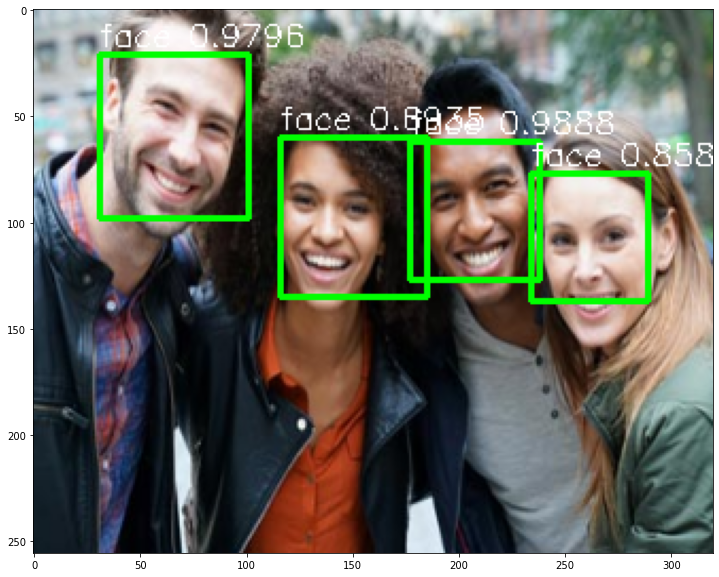

In [60]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [61]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


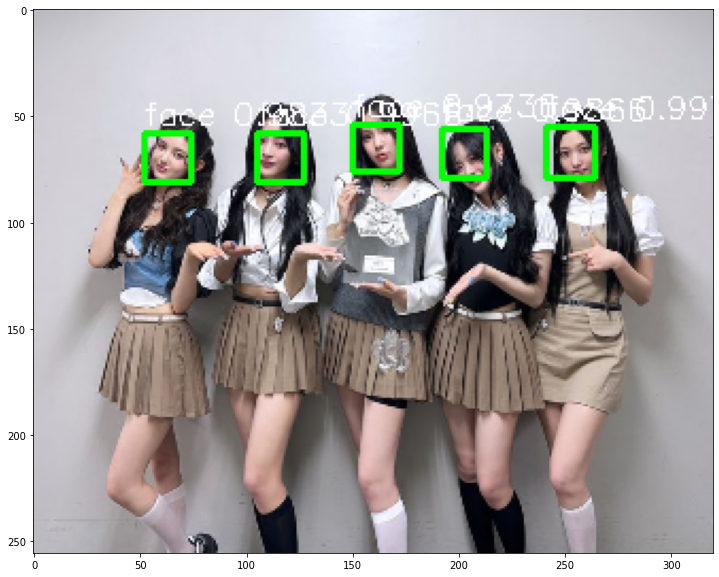

In [63]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [64]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


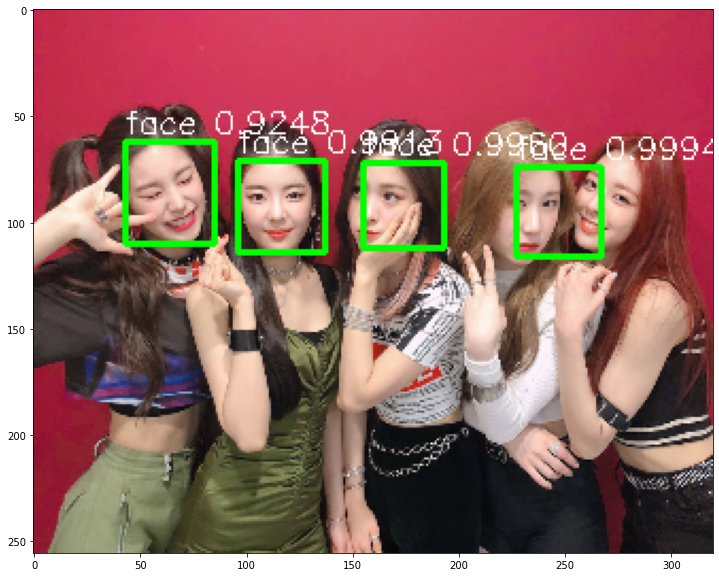

In [66]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [67]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


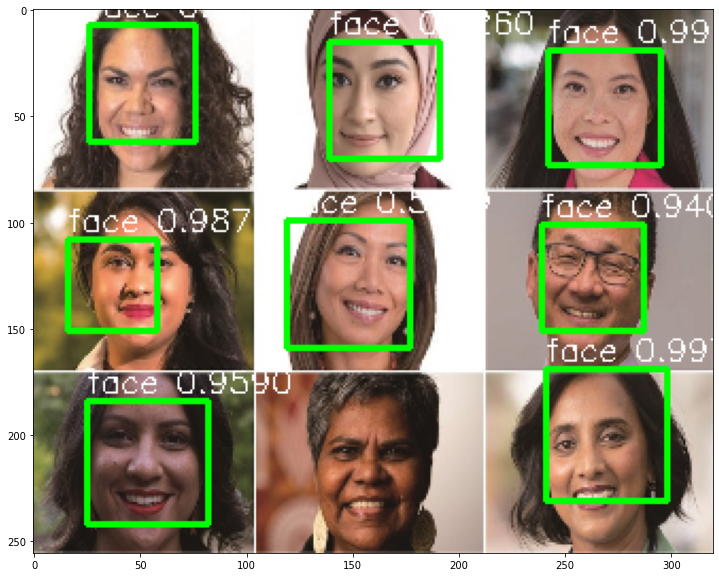

In [69]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [70]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


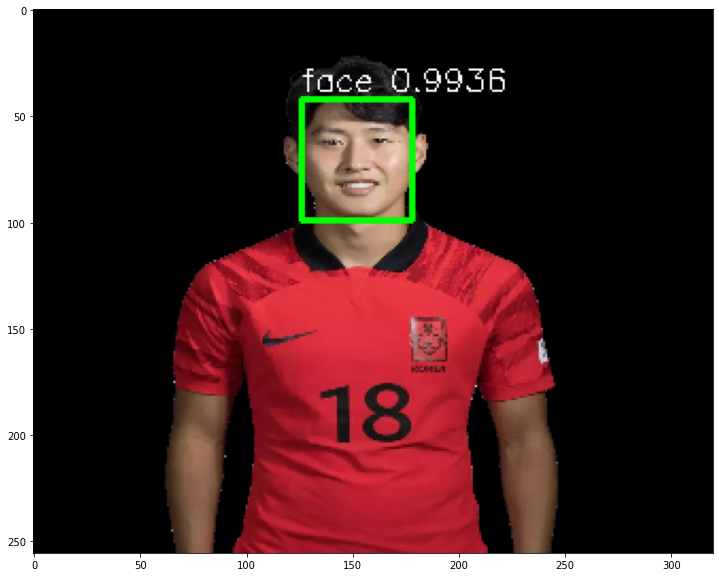

In [72]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [106]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image5.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


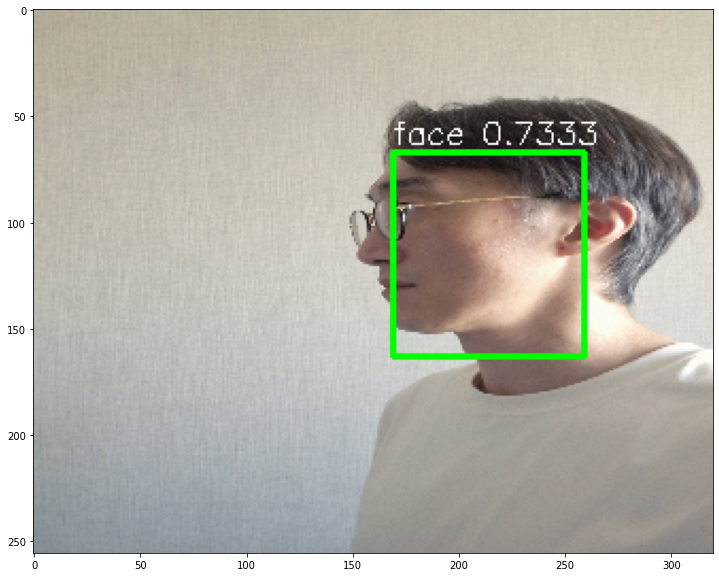

In [107]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [113]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image7.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


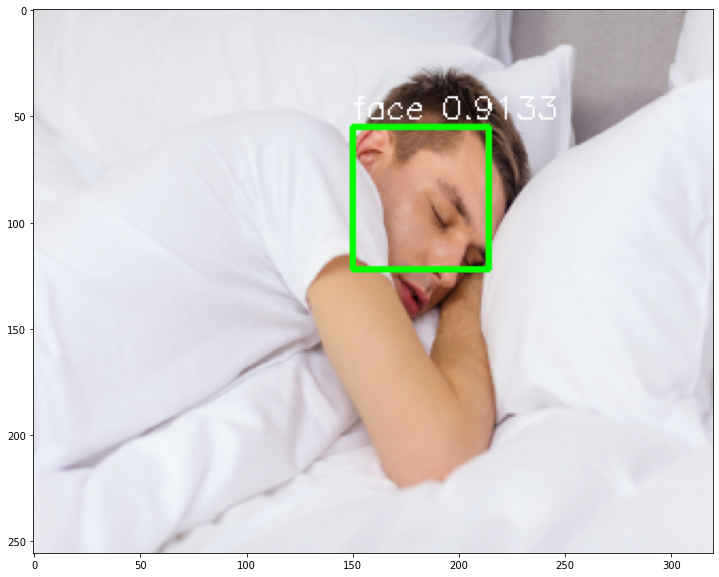

In [114]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [129]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image10.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


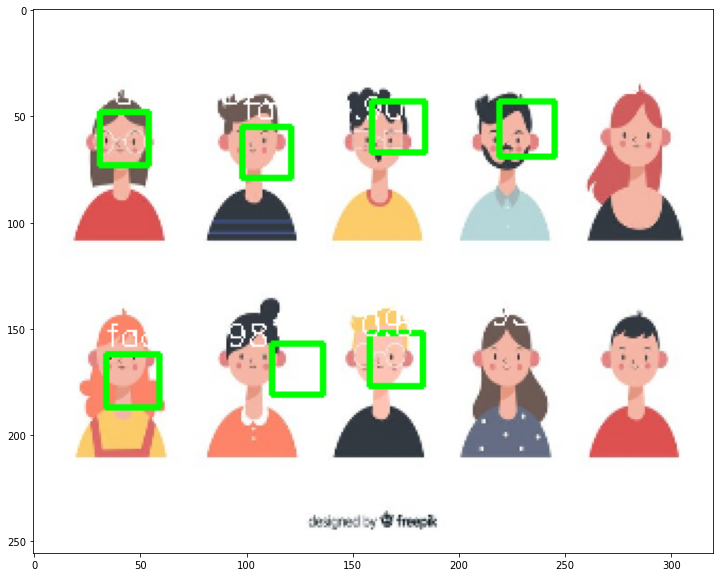

In [130]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=mymodel,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

### Step 4. 스티커 합성 사진 생성하기
---
여러분들이 선택한 인물사진에 스티커를 합성해 봅시다. 이미지에 너무 많은 사람 얼굴이 포함되어 있거나, 검출된 얼굴이 너무 작아서 스티커 합성이 어울리지 않으면 적당하지 않겠죠? 3~5명 정도의 얼굴이 포함된 적당한 사진을 선택해 주세요.

생성된 이미지를 프로젝트 코드와 함께 제출해 주세요~

그동안 수고 많으셨습니다!!!

### 얼굴에 왕관 스티커 합성하기

In [73]:
def put_stickers(img, boxes, prior_index, img_sticker):
    """
    얼굴 Bounding Box 위에 왕관 스티커를 정확한 위치와 크기로 표시합니다.

    :param img: 원본 이미지
    :param boxes: 예측된 Bounding Box 리스트
    :param prior_index: 현재 박스 인덱스
    :param img_sticker: 스티커 이미지 (RGBA 지원)
    :return: 스티커가 적용된 이미지
    """
    img_height, img_width = img.shape[:2]

    # Bounding Box 좌표 계산
    x_min = int(boxes[prior_index][0] * img_width)
    y_min = int(boxes[prior_index][1] * img_height)
    x_max = int(boxes[prior_index][2] * img_width)
    y_max = int(boxes[prior_index][3] * img_height)

    face_width = x_max - x_min
    face_height = y_max - y_min

    # 스티커 크기 조정
    sticker_width = int(face_width * 1.2)
    sticker_height = int(sticker_width * 0.5)
    img_sticker = cv2.resize(img_sticker, (sticker_width, sticker_height))

    # 왕관 위치 조정
    crown_x_min = x_min - (sticker_width - face_width) // 2
    crown_y_min = y_min - sticker_height + int(face_height * 0.15)
    crown_x_max = crown_x_min + sticker_width
    crown_y_max = crown_y_min + sticker_height

    # 이미지 경계 확인
    if (crown_y_min < 0 or crown_x_min < 0 or
        crown_x_max > img_width or crown_y_max > img_height):
        print("왕관 스티커가 이미지 범위를 벗어났습니다.")
        return img

    # 알파 채널을 사용해 스티커 합성
    sticker_area = img[crown_y_min:crown_y_max, crown_x_min:crown_x_max]
    
    if img_sticker.shape[-1] == 4:
        alpha_mask = img_sticker[:, :, 3] / 255.0  # 알파 채널 (0~1 범위)
        alpha_inv = 1.0 - alpha_mask
        
        # RGB 채널만 사용
        for c in range(0, 3):
            sticker_area[:, :, c] = (alpha_mask * img_sticker[:, :, c] +
                                     alpha_inv * sticker_area[:, :, c])
    else:
        # 알파 채널이 없을 경우 직접 합성
        sticker_area = np.where(
            img_sticker == 0,
            sticker_area,
            img_sticker
        ).astype(np.uint8)

    img[crown_y_min:crown_y_max, crown_x_min:crown_x_max] = sticker_area
    return img

In [74]:
def process_image_with_sticker(image_path, img_sticker, model, image_width, image_height, box_steps, image_labels):
    """
    이미지에서 얼굴을 검출하고 왕관 스티커를 적용한 후 시각화합니다.
    
    :param image_path: 입력 이미지 경로
    :param img_sticker: 왕관 스티커 이미지
    :param model: SSD 객체 탐지 모델
    :param image_width: 모델 입력 이미지 너비
    :param image_height: 모델 입력 이미지 높이
    :param box_steps: SSD 모델의 BOX_STEPS 값
    :param image_labels: 클래스 레이블 목록
    """
    # 이미지 불러오기 및 확인
    img_raw = cv2.imread(image_path)
    if img_raw is None:
        raise FileNotFoundError(f"이미지 파일을 찾을 수 없습니다: {image_path}")
    
    # 이미지 전처리**
    img_raw = cv2.resize(img_raw, (image_width, image_height))
    img = np.float32(img_raw.copy())
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 이미지 패딩
    img, pad_params = pad_input_image(img, max_steps=max(box_steps))
    img = img / 255.0  # 정규화
    
    # Default Box 생성 및 모델 예측
    boxes = default_box()
    boxes = tf.cast(boxes, tf.float32)
    
    predictions = model.predict(img[np.newaxis, ...])
    pred_boxes, labels, scores = parse_predict(predictions, boxes)
    pred_boxes = recover_pad(pred_boxes, pad_params)
    
    # 왕관 스티커 적용
    for box_index in range(len(pred_boxes)):
        img_raw = put_stickers(img_raw, pred_boxes, box_index, img_sticker)
    
    # 결과 시각화
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
    plt.show()

In [75]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')

왕관 스티커가 이미지 범위를 벗어났습니다.


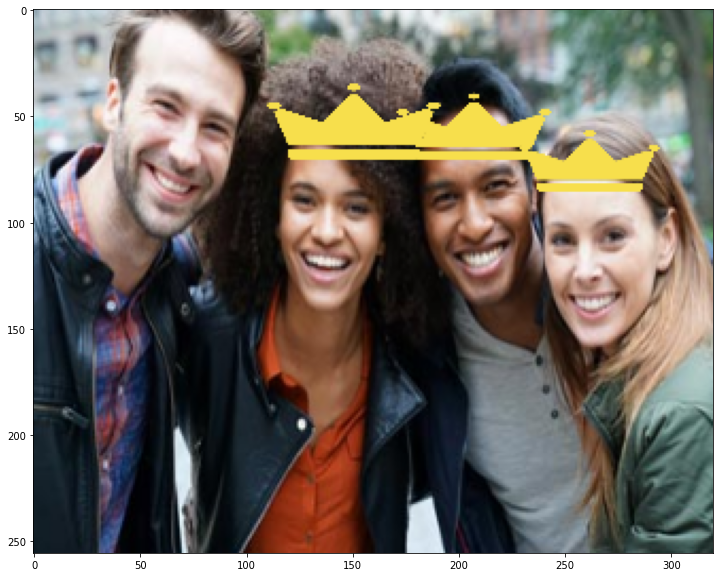

In [77]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=mymodel,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [78]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')

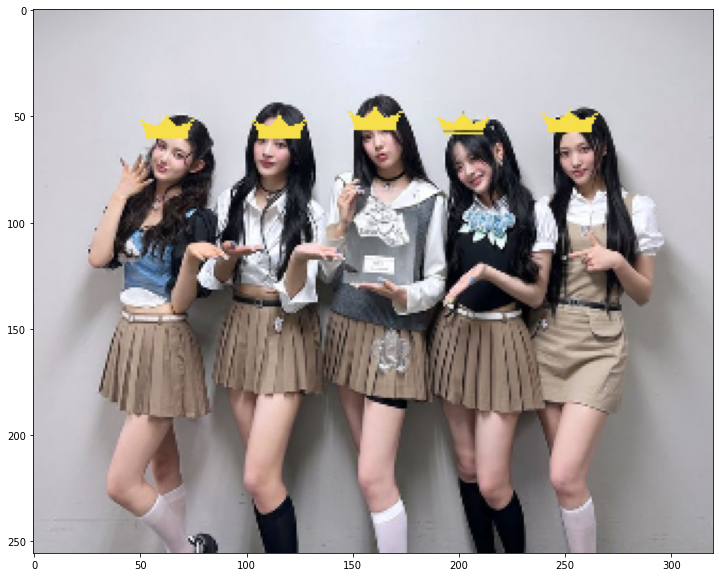

In [80]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=mymodel,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [81]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')

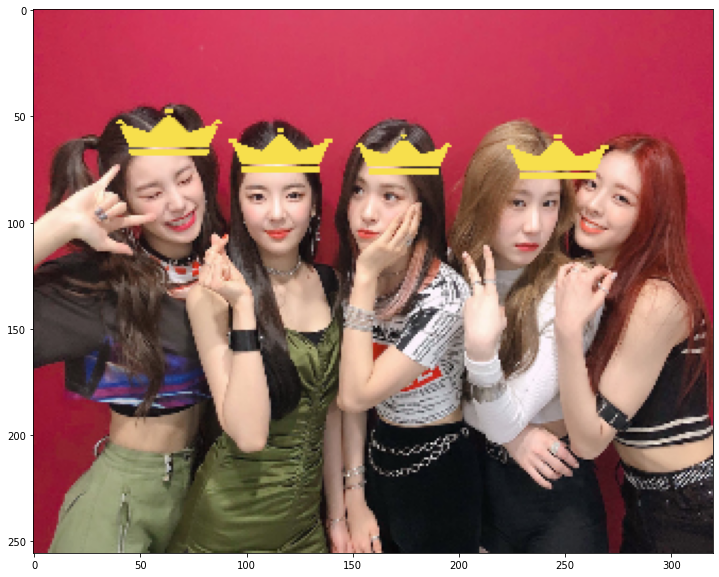

In [83]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=mymodel,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [84]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')

왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.


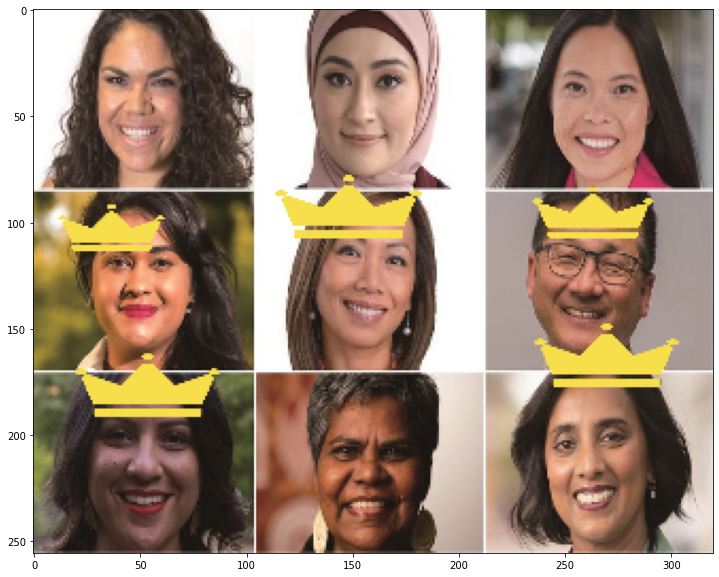

In [86]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=mymodel,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [87]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')

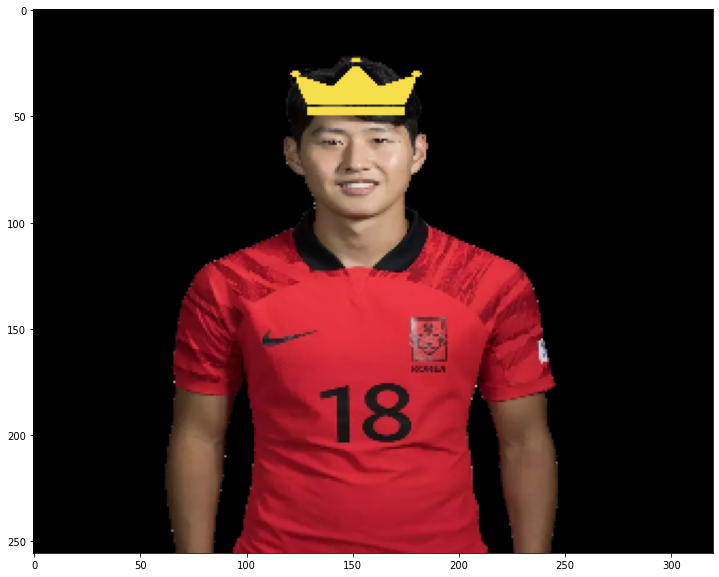

In [89]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=mymodel,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

### Step 3. dlib 을 이용한 landmark 찾기 (선택사항)
---
붙이려는 이미지에 따라 face landmark를 찾아야 할 수도 있습니다. 검출된 bounding box에 dlib을 적용해 face landmark를 찾을 수 있을 것입니다.
dlib를 이용하려는 경우, inference.py 에서 show_image 메소드를 사용한 부분을 적절히 수정해야 가능할 것입니다.

In [90]:
import dlib

In [91]:
landmark_model_path = os.getenv('HOME')+'/aiffel/camera_sticker/models/shape_predictor_68_face_landmarks.dat'
    # 저장한 landmark 모델의 주소를 model_path 변수에 저장
landmark_predictor = dlib.shape_predictor(landmark_model_path)
    # dlib 라이브러리의 shape_predictor 함수를 이용하여 모델을 불러옴
    # landmark_predictor는 RGB이미지와 dlib.rectangle를 입력 받고 dlib.full_object_detection를 반환
    # dlib.rectangle: 내부를 예측하는 박스
    # dlib.full_object_detection: 각 구성 요소의 위치와, 이미지 상의 객체의 위치를 나타냄

In [97]:
def detect_faces_and_landmarks(TEST_IMAGE_PATH):
    """
    이미지에서 얼굴을 검출하고 랜드마크를 예측하는 함수
    
    Args:
        TEST_IMAGE_PATH (str): 테스트할 이미지의 경로.
        
    Returns:
        list_landmarks (list): 검출된 얼굴들의 랜드마크 포인트 리스트.
    """
    # 1. 이미지 로드 및 전처리
    img_raw = cv2.imread(TEST_IMAGE_PATH)  # 이미지 읽기
    img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))  # 이미지 리사이즈
    img = np.float32(img_raw.copy())  # 이미지 복사 및 float32로 변환
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # BGR → RGB 변환
    img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))  # 패딩
    img = img / 255.0  # 정규화
    
    # 2. Default Box 및 예측 수행
    boxes = default_box()
    boxes = tf.cast(boxes, tf.float32)  # TensorFlow Tensor로 변환
    
    predictions = mymodel.predict(img[np.newaxis, ...])  # 모델 예측 수행
    pred_boxes, labels, scores = parse_predict(predictions, boxes)  # 예측 결과 파싱
    pred_boxes = recover_pad(pred_boxes, pad_params)  # 패딩 복구
    
    # 3. Bounding Box & Landmark 검출
    list_landmarks = []
    
    for box in pred_boxes:
        # Bounding Box 좌표 변환
        x_min = int(box[0] * IMAGE_WIDTH)
        y_min = int(box[1] * IMAGE_HEIGHT)
        x_max = int(box[2] * IMAGE_WIDTH)
        y_max = int(box[3] * IMAGE_HEIGHT)
        
        # 바운딩 박스 그리기
        cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
        
        # dlib.rectangle 변환
        dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
        
        # 랜드마크 예측
        points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
        
        # (x, y) 형태로 변환하여 저장
        list_points = list(map(lambda p: (p.x, p.y), points.parts()))
        list_landmarks.append(list_points)
        
        # 랜드마크 포인트 그리기
        for (x, y) in list_points:
            cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트
    
    # 4. 검출된 얼굴 및 랜드마크 수 출력
    print(f"검출된 얼굴 수: {len(list_landmarks)}")
    if len(list_landmarks) > 0:
        print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")
    
    # 5. 결과 시각화
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    
    return list_landmarks

검출된 얼굴 수: 4
첫 번째 얼굴의 랜드마크 수: 68


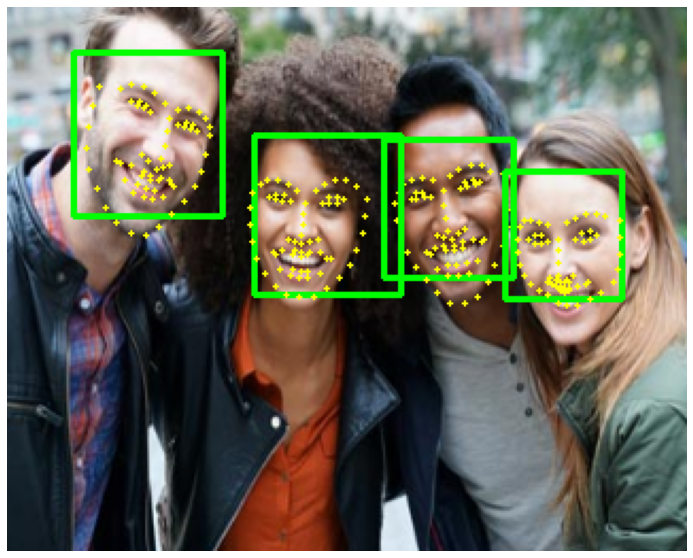

In [99]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')
landmarks = detect_faces_and_landmarks(TEST_IMAGE_PATH)

검출된 얼굴 수: 5
첫 번째 얼굴의 랜드마크 수: 68


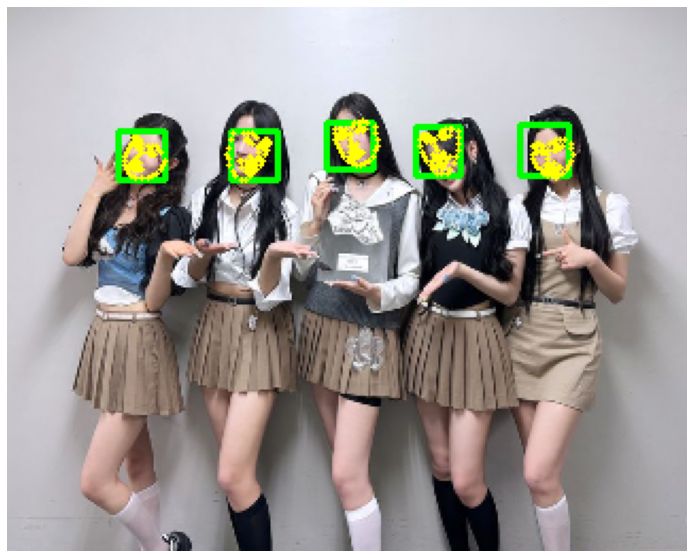

In [100]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')
landmarks = detect_faces_and_landmarks(TEST_IMAGE_PATH)

검출된 얼굴 수: 4
첫 번째 얼굴의 랜드마크 수: 68


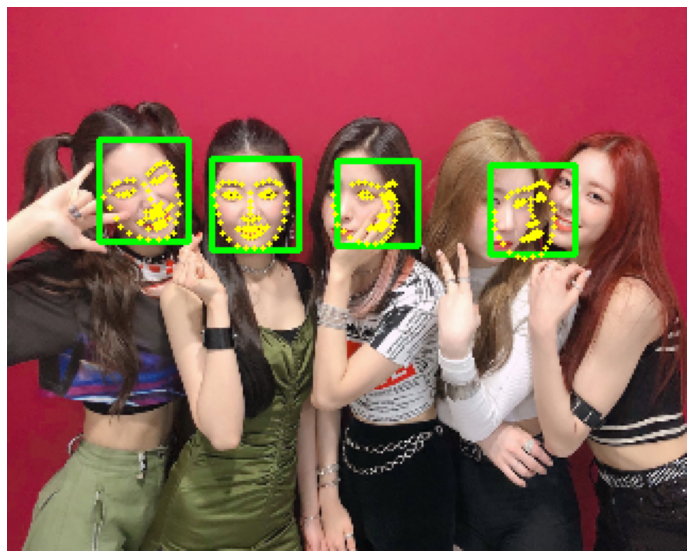

In [101]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')
landmarks = detect_faces_and_landmarks(TEST_IMAGE_PATH)

검출된 얼굴 수: 1
첫 번째 얼굴의 랜드마크 수: 68


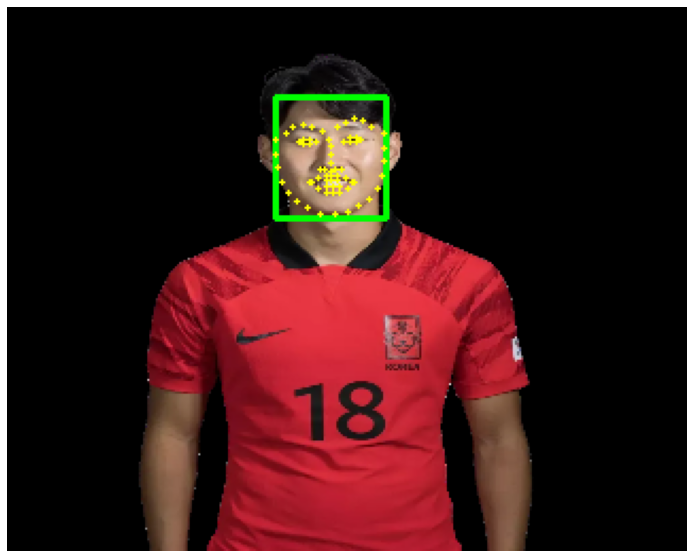

In [102]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')
landmarks = detect_faces_and_landmarks(TEST_IMAGE_PATH)

검출된 얼굴 수: 8
첫 번째 얼굴의 랜드마크 수: 68


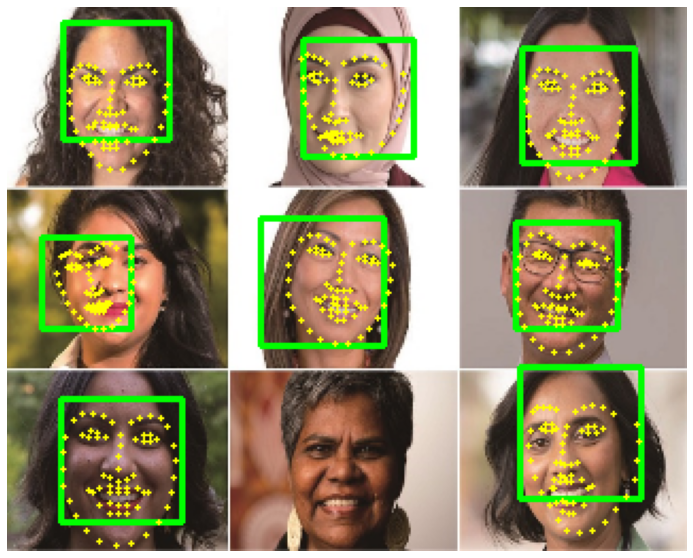

In [103]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')
landmarks = detect_faces_and_landmarks(TEST_IMAGE_PATH)

# 회고
- 사전 학습 된 weights_epoch_008.h5 을 가져온 모델에서 결과 이미지의 성능이 좋지 않게 나오고 있다.
    - 100 epoch 을 추가로 더 학습하여 결과를 비교 한다.
- 추가 실험 결과 100 epoch 을 학습 후 테스트한 대부분의 사진에서 성능이 올라 갔다.
- 여러 사진을 추가 실험 하면서 아래 부분을 확인 할 수 있었다.
    - dlib 의 detector_hog 를 이용한 다인종 여성의 정면 사진 결과와 비교시 SSD 성능이 떨어졌다.
    - 반면 dlib 에서는 detect 를 하지 못했던 측면이나 누워있는 사진의 얼굴 검출이 SSD 는 가능 하였다.
    - 일러스트 사람 이미지 얼굴 인식은 그다지 좋지 못하였다.
- face detector 의 성능을 올리 기 위해 MediaPipe 등의 모델을 추가로 테스트 해볼 예정이다.

### 참고 이전 노드에서 dlib 의 detector_hog 결과
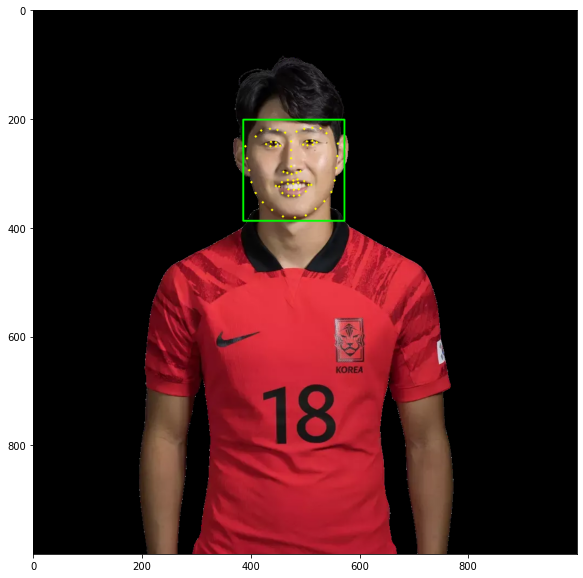
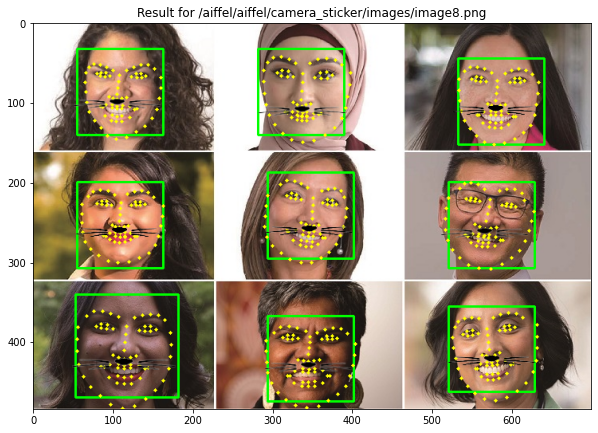

### 추가 실험 사진 : 성능이 좋지 않았던 사전 학습된 weights_epoch_008.h5 가중치 적용한 이미지 결과들
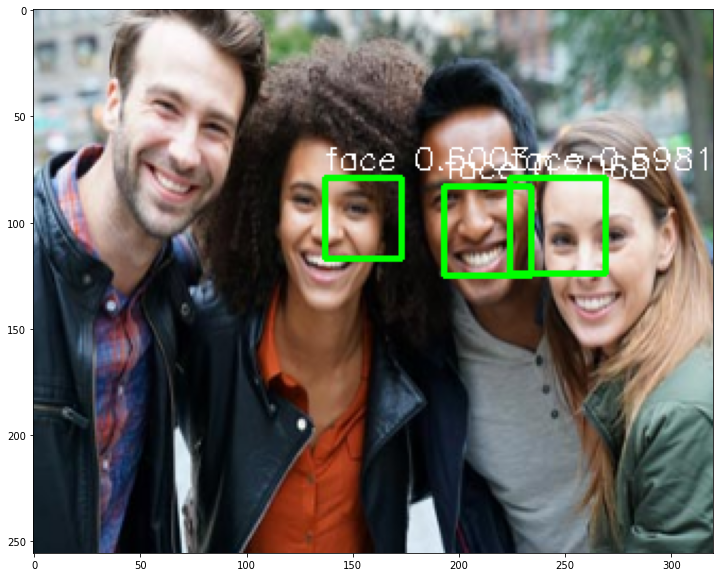
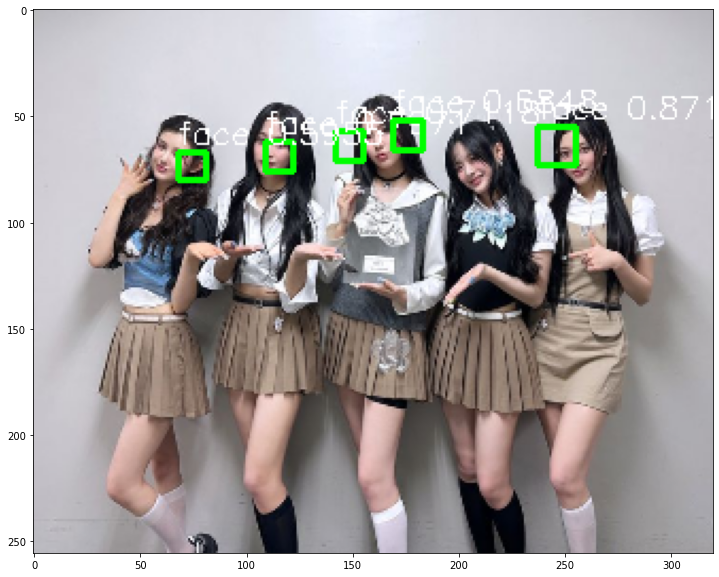
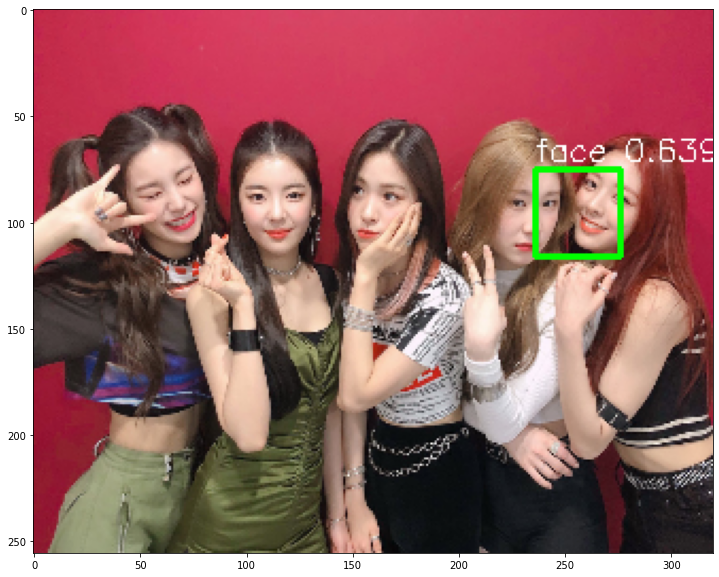
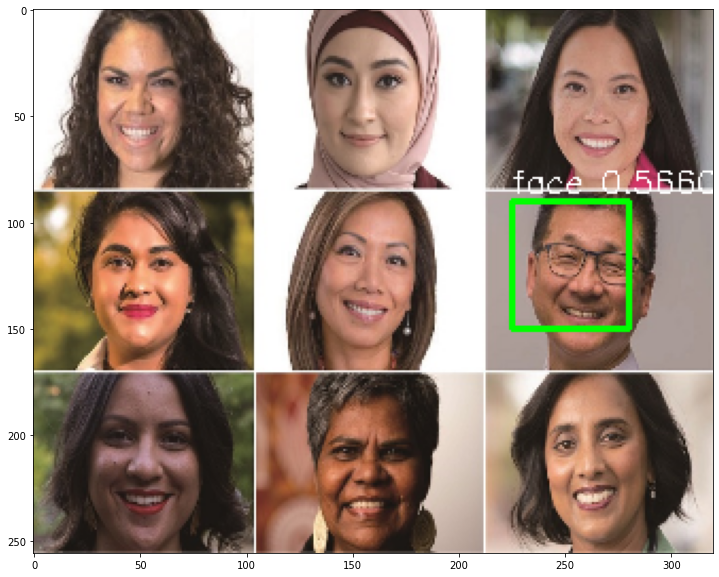
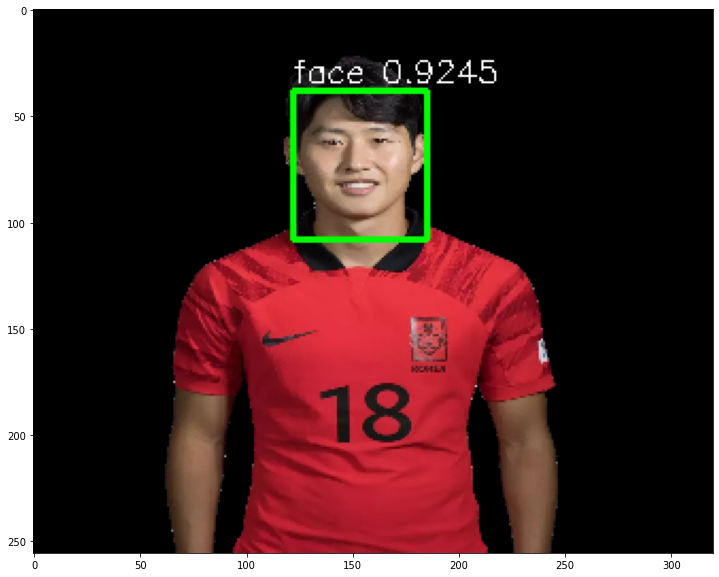
...
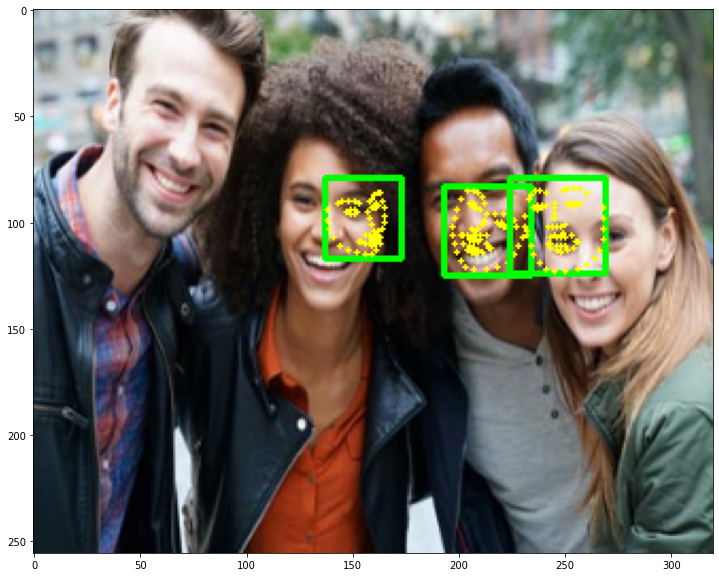
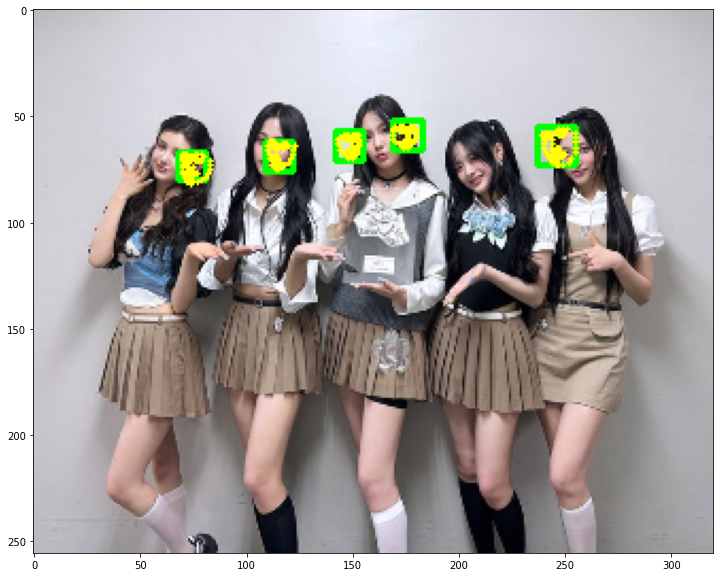
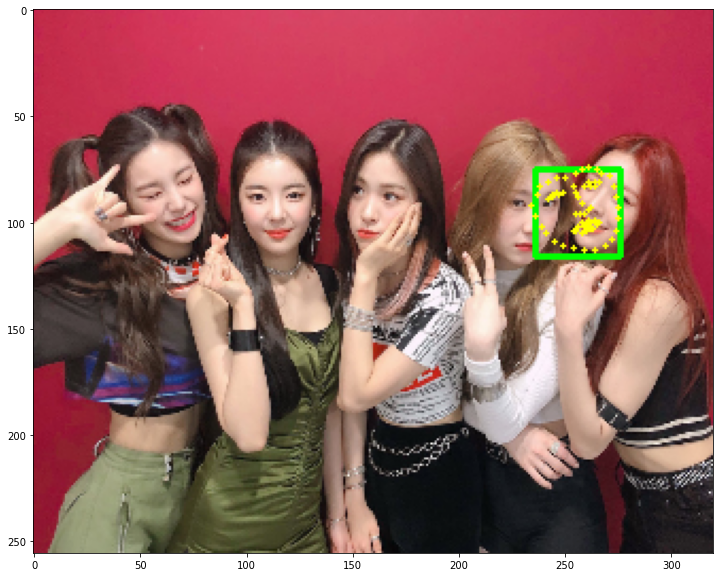
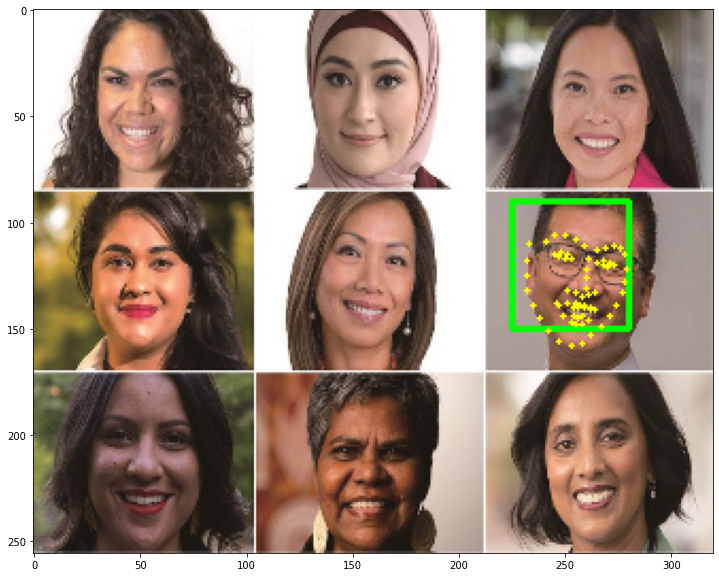

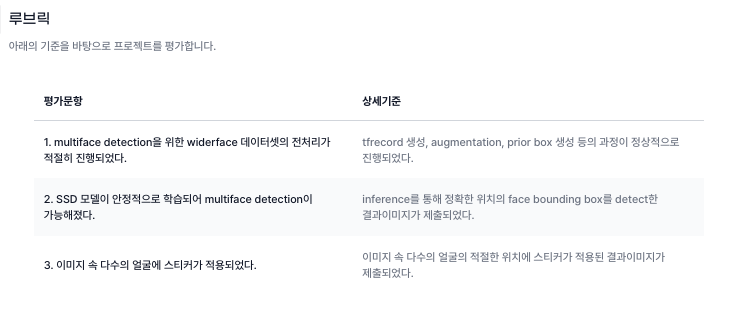